# Computes and plots the urban wind as forecasted for today.
# Use polytope kernel


In [1]:
#output_1 = cap.stdout.split('}\n')
#access_token = output_1[-1][0:-1]
#import earthkit.plots
from polytope.api import Client
import numpy as np
import pandas as pd
from src.urban_wind import get_wind_extreme_dt, read_cfd_wind, scale_cfd_wind, save_local_wind
from src.green_pont import load_json_with_comments
from src.plots_jupyter import wind_animation
from IPython.display import HTML

import matplotlib.pyplot as plt

LIVE_REQUEST = True

cf=load_json_with_comments('etc/settings_wind_maps.json')
path_cfd=cf['path_cfd'] 
angles=cf["angles"]
height=cf["height"]


In [2]:
LOCATION = ((51.213642, 4.415)) #  center of antwerp to get meteo data from ecmwf
wind_meteo=get_wind_extreme_dt(LOCATION,date='0')
print(wind_meteo)

2025-11-03 12:01:11 - INFO - Key read from /home/jovyan/.polytopeapirc
2025-11-03 12:01:11 - INFO - Sending request...
{'request': 'class: d1\n'
            'dataset: extremes-dt\n'
            "date: '0'\n"
            "expver: '0001'\n"
            'feature:\n'
            '  axes: step\n'
            '  points:\n'
            '  - - 51.213642\n'
            '    - 4.415\n'
            '  range:\n'
            '    end: 24\n'
            '    start: 0\n'
            '  type: timeseries\n'
            'levtype: sfc\n'
            'param: 166/165\n'
            'stream: oper\n'
            "time: '0000'\n"
            'type: fc\n',
 'verb': 'retrieve'}
2025-11-03 12:01:11 - INFO - Polytope user key found in session cache for user jovyan


HTTPResponseError: Polytope error
Situation: trying to submit a retrieval request
Description: HTTP CLIENT ERROR (401)
URL: https://polytope.lumi.apps.dte.destination-earth.eu:443/api/v1/requests/destination-earth
HTTP method: POST
Request header/body contents:
{'headers': {'Authorization': 'Bearer **********bmBA'}, 'json': {'verb': 'retrieve', 'request': "class: d1\ndataset: extremes-dt\ndate: '0'\nexpver: '0001'\nfeature:\n  axes: step\n  points:\n  - - 51.213642\n    - 4.415\n  range:\n    end: 24\n    start: 0\n  type: timeseries\nlevtype: sfc\nparam: 166/165\nstream: oper\ntime: '0000'\ntype: fc\n"}}
Expected responses: 200, 202, 204
Received response: CLIENT ERROR (401)
Details:
Authentication failed

In [7]:
# read pre-computed normalized CFD wind ratios

xc=153300
yc=211644
L=1000


crop_bounds = (xc-L, yc-L, xc+L, yc+L)
cfd_ratio=read_cfd_wind(path_cfd,angles, height,crop_bounds)
# scale meso-scale wind to local urban scale using CFD ratios
wind_local=scale_cfd_wind(wind_meteo, cfd_ratio)


Reading CFD wind files from  DATA_AntwerpWindStudy/wind_ratios
Scaling meso-scale wind to local urban scale using CFD ratios


In [ ]:
#from IPython.display import HTML
#ani=wind_animation(wind_local,vmin=0,vmax=4)
#HTML(ani.to_jshtml())


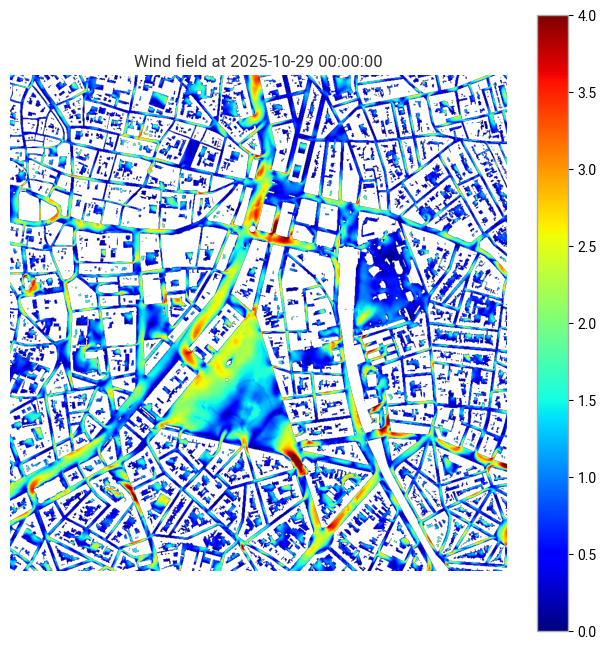

In [8]:


from matplotlib import animation
from IPython.display import HTML

times = sorted(wind_local.keys())

fig, ax = plt.subplots(figsize=(8,8))
all_values = np.concatenate([wind_local[t].ravel() for t in times])
vmin, vmax = np.percentile(all_values, [2, 98])  # robust color scale

im = ax.imshow(wind_local[times[0]], cmap='jet', animated=True, vmin=0, vmax=4)
cbar = fig.colorbar(im, ax=ax)
title = ax.set_title(f"Wind velocity [m/s] at {times[0]}")
ax.axis("off")

# Update function for animation
def update(frame):
    data = wind_local[times[frame]]
    im.set_array(data)
    title.set_text(f"Wind field at {times[frame]}")
    return [im, title]

# Build the animation
ani = animation.FuncAnimation(
    fig, update, frames=len(times), interval=800, blit=True
)

# Show in Jupyter
HTML(ani.to_jshtml())



In [ ]:
plt.close()